# Embedded animation example
This notebook demonstrates how to generate simple embedded animations in Jupyter.  

Adapted from:
http://louistiao.me/posts/notebooks/embedding-matplotlib-animations-in-jupyter-as-interactive-javascript-widgets/

In [2]:
import numpy as np
import matplotlib.pyplot as plt

from matplotlib import animation, rc
from IPython.display import HTML

## First example is a simple line plot

### First initialize a figure, axis, and line object

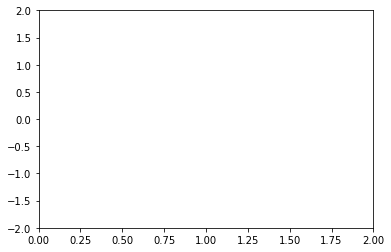

In [3]:
fig, ax = plt.subplots()

ax.set_xlim(( 0, 2))
ax.set_ylim((-2, 2))

line, = ax.plot([], [], lw=2)

### define an init function. This will be called once to initialize the plot.

In [4]:
def init():
    line.set_data([], [])
    return (line,)

### define an animate function. This will be called once per frame

In [5]:
def animate(i):
    x = np.linspace(0, 2, 1000)
    y = np.sin(2 * np.pi * (x - 0.01 * i))
    line.set_data(x, y)
    return (line,)

### define the animation itself

In [7]:
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=100, interval=20, 
                               blit=True)

### Render the animation as an html5 video. This requires ffmpeg to be installed.

In [8]:
HTML(anim.to_html5_video())

### Render the animation as an embedded javascript animation. This does not require ffmpeg and is interactive, which is nice.

In [9]:
HTML(anim.to_jshtml())

## Repeat for a 3 dimensional (x, y, z) heatmap/image

### Define a function to generate an array

In [10]:
def make_array(exponent):
    x = np.arange(0, 5, 0.01)
    y = np.arange(0, 5, 0.01)
    xx, yy = np.meshgrid(x, y, sparse=True)

    return np.sin(xx**exponent + yy**exponent)

### Intitialize a figure, axis, and image object

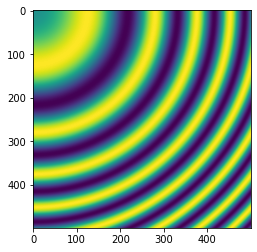

In [11]:
fig, ax = plt.subplots()

im = ax.imshow(make_array(2))

### define our init and animate functions, just like above

In [12]:
def init():
    im.set_data(make_array(0))
    return (im,)

def animate(i):
    F =50
    im.set_data(make_array(i/F))
    ax.set_title('i = {}, function_input = {}'.format(i, i/F))
    return (im,)

### Define our animation object

In [13]:
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=200, interval=50, 
                               blit=True)

### Build an html5 video

In [14]:
HTML(anim.to_html5_video())

### Generate a javascript animation

In [16]:
HTML(anim.to_jshtml())